# 2D Physics Engine for Collisions

## Project Overview
This Jupyter Notebook implements a 2D physics engine to simulate the motion and collisions of multiple balls. The simulation incorporates object-oriented programming (OOP) principles, mathematical equations for motion and collisions, and visualization using Matplotlib animations. The goal is to model realistic physical interactions, including gravity, friction, elastic collisions and inelastic collisions, while visualizing the dynamic behavior of the system.

## Objectives
- **OOP Requirements**: Define a `Ball` class with attributes like position, velocity, mass, radius, and color, and methods for updating positions and handling collisions.
- **Math Requirements**: Implement equations of motion under gravity and friction, and resolve collisions using momentum conservation and the coefficient of restitution.
- **Visualization**: Use Matplotlib to animate the motion and collisions of balls in a 2D space.

## Simulation Parameters
The simulation uses the following constants:
- **Coefficient of Restitution (e)**: Set to 0 for perfectly inelastic collisions, meaning colliding balls stick together or lose all relative velocity along the collision normal.
- **Gravity**: -9.8 m/s², acting downward to simulate realistic falling motion.
- **Friction**: A damping factor of 0.995 applied to velocities to simulate energy loss due to air resistance or surface friction.
- **Time Step (DT)**: 0.05 seconds, controlling the simulation's temporal resolution.

Let's proceed with the implementation, breaking down the code into sections with explanations.

# Step 1: Import Libraries and Define Constants

## Purpose
We start by importing the necessary Python libraries for numerical computations, plotting, and animations. We also define the physical constants that govern the simulation's behavior.

## Libraries Used
- **NumPy**: For efficient numerical computations, such as vector operations and distance calculations.
- **Matplotlib**: For creating plots and animations to visualize the balls' motion.
- **Random**: To generate random initial conditions for the balls (position, velocity, radius, color).

## Constants
- `COEFFICIENT_OF_RESTITUTION`: Determines the elasticity of collisions (0 = inelastic).
- `GRAVITY`: Simulates the downward acceleration due to gravity.
- `FRICTION`: Reduces velocity over time to mimic energy dissipation.
- `DT`: The time step for updating positions and velocities, ensuring numerical stability.

In [480]:
%matplotlib notebook
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import random

# Simulation constants
COEFFICIENT_OF_RESTITUTION = 1  # 1 for perfectly elastic and < 1 for Inelastic
GRAVITY = -9.8                    # Pulling downwards
FRICTION = 0.995                  # Velocity damping
DT = 0.05                         # Time step
ELECTROSTATIC_CONSTANT = 3.0     # Toggle the value between 0.3 (for lower force) to 5 or even greater (for stronger force)


# Step 2: Define the Ball Class

## Purpose
The `Ball` class encapsulates the properties and behaviors of each ball in the simulation. This object-oriented approach organizes the code and makes it easy to manage multiple balls with different attributes.

## Attributes
- `x, y`: Position coordinates of the ball's center.
- `vx, vy`: Velocity components in the x and y directions.
- `mass`: Mass of the ball, influencing collision dynamics.
- `radius`: Radius of the ball, used for collision detection and visualization.
- `color`: Color of the ball for visualization.

## Methods
- `update_position`: Updates the ball's position using its velocity, applies gravity, and incorporates friction.
- `check_wall_collision`: Ensures the ball stays within the simulation boundaries by reversing velocity (if elastic) and adjusting position.
- `check_collision`: Detects if the ball collides with another ball based on their distance and radi (The distance is being calculated using the Euclidean Distance Method- hypot() function).
- `resolve_collision`: Computes new velocities after a collision using momentum conservation and resolves overlap to prevent balls from sticking together.

## Collision Physics
The `resolve_collision` method uses the following principles:
- **Momentum Conservation**: The total momentum before and after the collision is conserved along the normal direction.
- **Coefficient of Restitution**: **e = 1:** perfectly elastic.
                                  **0 < e < 1:** partially inelastic.
                                  **e = 0:** perfectly inelastic (objects stick in direction, though your simulation keeps them separate).
- **Overlap Resolution**: Prevents "sticking" or tunneling by pushing the balls apart based on their overlap.
                          Adjusts positions symmetrically to avoid introducing bias.
                          Adds a small epsilon (+ 0.01) to ensure numerical separation

In [482]:
# Ball class
class Ball:
    def __init__(self, x, y, vx, vy, mass, radius, color):
        self.x = x
        self.y = y
        self.vx = vx
        self.vy = vy
        self.mass = mass
        self.radius = radius
        self.color = color

    def update_position(self):
        # Apply gravity
        self.vy += GRAVITY * DT
        
        # Apply position updates
        self.x += self.vx * DT
        self.y += self.vy * DT

        # Apply friction
        self.vx *= FRICTION
        self.vy *= FRICTION

    def check_wall_collision(self, width, height):
        if self.x - self.radius < 0:
            self.x = self.radius
            self.vx *= -COEFFICIENT_OF_RESTITUTION
        if self.x + self.radius > width:
            self.x = width - self.radius
            self.vx *= -COEFFICIENT_OF_RESTITUTION
        if self.y - self.radius < 0:
            self.y = self.radius
            self.vy *= -COEFFICIENT_OF_RESTITUTION
        if self.y + self.radius > height:
            self.y = height - self.radius
            self.vy *= -COEFFICIENT_OF_RESTITUTION

    def check_collision(self, other):
        dx = self.x - other.x
        dy = self.y - other.y
        distance = np.hypot(dx, dy)
        return distance < self.radius + other.radius

    def apply_repulsion(self, others):
        for other in others:
            if other is self:
                continue
            dx = self.x - other.x
            dy = self.y - other.y
            dist_sq = dx**2 + dy**2
            if dist_sq == 0:
                continue  

            force = ELECTROSTATIC_CONSTANT / dist_sq
            dist = np.sqrt(dist_sq)
            fx = force * (dx / dist)
            fy = force * (dy / dist)

            # Apply force to velocity (F = ma)
            self.vx += (fx / self.mass) * DT
            self.vy += (fy / self.mass) * DT

    
            
    def resolve_collision(self, other):
        dx = other.x - self.x
        dy = other.y - self.y
        distance = np.hypot(dx, dy)
        if distance == 0:
            return

        nx, ny = dx / distance, dy / distance
        tx, ty = -ny, nx

        v1n = self.vx * nx + self.vy * ny
        v1t = self.vx * tx + self.vy * ty
        v2n = other.vx * nx + other.vy * ny
        v2t = other.vx * tx + other.vy * ty

        # Special rule: red-green collision has zero elasticity
        if {'red', 'green'} == {self.color, other.color}:
            e = 0.0
        else:
            e = COEFFICIENT_OF_RESTITUTION

        m1, m2 = self.mass, other.mass

        v1n_new = (v1n * (m1 - e * m2) + (1 + e) * m2 * v2n) / (m1 + m2)
        v2n_new = (v2n * (m2 - e * m1) + (1 + e) * m1 * v1n) / (m1 + m2)

        self.vx = v1n_new * nx + v1t * tx
        self.vy = v1n_new * ny + v1t * ty
        other.vx = v2n_new * nx + v2t * tx
        other.vy = v2n_new * ny + v2t * ty

        # Resolve overlap
        overlap = 0.5 * (self.radius + other.radius - distance + 0.01)
        self.x -= overlap * nx
        self.y -= overlap * ny
        other.x += overlap * nx
        other.y += overlap * ny



# Step 3: Utility Function for Stopping Condition

## Purpose
The `all_balls_at_rest` function checks if all balls have come to a near standstill, defined by a velocity threshold. This is used to stop the animation when the system reaches equilibrium, saving computational resources.

## Implementation
- The function calculates the speed of each ball using the Euclidean norm of its velocity (`np.hypot(vx, vy)`).
- It returns `True` if all balls have a speed below the threshold (0.1), indicating they are effectively at rest.

In [484]:
def all_balls_at_rest(threshold=0.1):
    return all(np.hypot(ball.vx, ball.vy) < threshold for ball in balls)

# Step 4: Initialize the Simulation

## Purpose
This section sets up the simulation environment, including the dimensions of the 2D space and the initial conditions of the balls.

## Setup Details
- **World Dimensions**: The simulation occurs in a 10x10 unit square.
- **Number of Balls**: 20 balls are created with random properties.
- **Ball Properties**:
  - **Radius**: Randomly chosen between 0.2 and 1.5 units.
  - **Mass**: Proportional to radius (mass = radius * 2).
  - **Position**: Randomly placed within the world, ensuring they don't start outside the boundaries.
  - **Velocity**: Random initial velocities between -10 and 10 units/second in both x and y directions.
  - **Color**: Randomly selected from a predefined list for visual distinction.

In [486]:
# Simulation setup
width, height = 10, 10
num_balls = 20
colors = ['red', 'blue', 'green', 'purple', 'orange', 'cyan']
balls = []

for _ in range(num_balls):
    radius = random.uniform(0.2, 0.5)
    mass = radius * 2
    x = random.uniform(radius, width - radius)
    y = random.uniform(radius, height - radius)
    vx = random.uniform(-2, 5)
    vy = random.uniform(-2, 5)
    color = random.choice(colors)
    balls.append(Ball(x, y, vx, vy, mass, radius, color))

# Step 5: Set Up Plotting and Visualization

## Purpose
We initialize the Matplotlib figure and create circular patches to represent the balls. This sets the stage for the animation.

## Implementation
- A figure and axis are created with equal aspect ratio to ensure the 2D space is not distorted.
- The axis limits are set to the world dimensions (0 to 10 for both x and y).
- Each ball is represented by a `plt.Circle` patch, initialized at its starting position with its radius and color.
- Patches are added to the axis for rendering.

In [488]:
# Plotting
fig, ax = plt.subplots()
ax.set_xlim(0, 10)
ax.set_ylim(0, 10)
ax.set_aspect('equal')
patches = [plt.Circle((ball.x, ball.y), ball.radius, color=ball.color) for ball in balls]
for patch in patches:
    ax.add_patch(patch)

<IPython.core.display.Javascript object>

# Step 6: Define the Animation Function

## Purpose
The `animate` function updates the state of the simulation for each frame of the animation. It handles physics updates, collision detection, and visualization updates.

## Steps in Animation
1. **Update Positions**: Each ball's position is updated based on its velocity, gravity, and friction.
2. **Wall Collisions**: Check and handle collisions with the simulation boundaries.
3. **Ball Collisions**: Detect and resolve collisions between pairs of balls.
4. **Update Patches**: Move the circular patches to the balls' new positions for visualization.
5. **Check Stopping Condition**: Stop the animation if all balls are at rest.

## Animation Efficiency
- The `blit=True` parameter optimizes rendering by only updating changed parts of the plot.
- The stopping condition prevents unnecessary computation once the system stabilizes.

In [490]:
# Animate function
for ball in balls:
    ball.apply_repulsion(balls)
    ball.update_position()
    ball.check_wall_collision(width, height)

def animate(frame):
    for ball in balls:
        ball.update_position()
        ball.check_wall_collision(width, height)

    for i in range(len(balls)):
        for j in range(i + 1, len(balls)):
            if balls[i].check_collision(balls[j]):
                balls[i].resolve_collision(balls[j])

    for i, patch in enumerate(patches):
        patch.center = (balls[i].x, balls[i].y)

    if all_balls_at_rest():
        anim.event_source.stop()

    return patches

# Step 7: Run the Animation

## Purpose
This final step creates and runs the animation, displaying the simulation in the Jupyter Notebook.

## Implementation
- The `FuncAnimation` function is used to create the animation, calling the `animate` function for each frame.
- Parameters:
  - `interval=30`: Sets the delay between frames in milliseconds (approximately 33 fps).
  - `frames=600`: Limits the maximum number of frames to prevent infinite loops.
  - `blit=True`: Improves performance by only redrawing changed elements.
  - `cache_frame_data=False`: Prevents memory issues by not caching frame data.
- A title is added to the plot, indicating the simulation's key parameters.
- The grid is disabled for a cleaner visualization.

## Note on Visualization
The `%matplotlib notebook` magic command enables interactive plots in Jupyter.

In [492]:
# Run animation
anim = FuncAnimation(fig, animate, interval=30, frames=600, blit=True, cache_frame_data=False)
plt.title(f"2D Physics Engine - Gravity + Friction - e = {COEFFICIENT_OF_RESTITUTION}")
plt.grid(True)
HTML(anim.to_jshtml())

# Step 8: Energy Analysis and Visualization

## Purpose
This final step of the simulation focuses on analyzing and visualizing the conservation of energy within the system. It calculates the total energy (kinetic + potential) for different groups of balls (based on color) over time and presents these findings both graphically and in a tabular format. This helps in verifying the physical realism of the collision model, especially concerning energy dissipation (due to friction or inelastic collisions) or conservation (in an idealized elastic system).

## Implementation Details

1.  **Energy Calculation Function (`compute_energy_by_color`)**:
    * Defines a function that takes the list of `balls` as input.
    * It iterates through each ball, calculating its kinetic and potential energy.
        * Kinetic Energy is calculated as $KE = 0.5 \times m \times (v_x^2 + v_y^2)$, where $m$ is mass, and $v_x, v_y$ are velocity components.
        * Potential Energy is calculated as $PE = m \times |g| \times y$, where $m$ is mass, $g$ is gravity, and $y$ is the vertical position of the ball.
    * The function aggregates these energies for each unique ball color, returning a dictionary where keys are colors and values are their respective total energies.
    * It includes a check to handle an empty list of balls, returning an empty dictionary in such cases.

2.  **Simulation Setup and Energy Tracking**:
    * Initializes parameters for the energy analysis part of the simulation, such as `num_steps` and `time_points`.
    * Identifies all unique ball colors present in the simulation.
    * Sets up an `energy_history` dictionary to store a time-series of energy data for each unique ball color.
    * Includes error handling to print a message if the `balls` list is not initialized or is empty before starting the energy tracking.
    * Calculates and stores the initial total energy for each color group using the `compute_energy_by_color` function.

3.  **Simulation Loop for Energy Analysis**:
    * The core simulation logic (from previous steps, including `ball.apply_repulsion`, `ball.update_position`, `ball.check_wall_collision`, and inter-ball collision resolution) is re-run for `num_steps`.
    * In each step of this loop:
        1.  All physical interactions (repulsion, position updates, wall collisions, ball-to-ball collisions) are processed for all balls.
        2.  After these updates, the `compute_energy_by_color` function is called to get the current total energy for each color group.
        3.  These current energy values are appended to the respective lists in the `energy_history` dictionary.
    * Progress messages are printed during the simulation.

4.  **Plotting Energy Conservation**:
    * Uses `matplotlib` (with `%matplotlib inline`) for generating plots.
    * A figure is created to display the energy conservation graph.
    * For each ball color present in `energy_history`:
        * The energy values over time are normalized with respect to their initial energy (i.e., $E_{current} / E_{initial} \times 100\%$).
        * This normalized energy (Remaining Energy %) is plotted against time.
        * Each color group is represented by a distinct line, labeled appropriately (e.g., "Red Balls").
    * A horizontal dashed line is drawn at 100% to represent the initial energy level for easy comparison.
    * The plot is given a title ("Energy Conservation by Ball Color Over Time"), and axes are labeled ("Time (s)" and "Remaining Energy (%)").
    * A legend and grid are added for clarity.
    * The generated plot is displayed inline within the notebook and also saved as an image file (`energy_plot.png`).
    * Includes error handling in case plotting fails for any color group.

5.  **Tabular Energy Statistics**:
    * After the plotting, a formatted table summarizing energy statistics is printed to the console.
    * This table includes columns for:
        * Color
        * Initial Energy (in Joules)
        * Final Energy (in Joules)
        * Energy Loss (as a percentage)
    * Statistics are provided for each individual color group.
    * Finally, total initial energy, total final energy, and total percentage energy loss for the entire system (all balls combined) are calculated and printed.
    * Handles cases where no ball data or energy history is available to prevent errors during table generation.

## Key Outputs
* **Energy Conservation Plot (`energy_plot.png` and inline display)**: A visual representation that shows how the total energy of different colored ball groups (and implicitly the whole system) evolves throughout the simulation. This plot is crucial for observing energy dissipation due to factors like friction and inelastic collisions.
* **Energy Statistics Table (console output)**: A quantitative summary providing precise figures for initial and final energies, and the percentage of energy lost for each color group and the system as a whole. This table offers a clear, numerical measure of the simulation's energy dynamics and conservation properties.



"in case the below cells shows error rerun the cell. This error occurs due to a conflict between Jupyter notebook's interactive backend and Matplotlib's figure management."


Number of balls at start of energy tracking: 20
Unique colors found: {'cyan', 'blue', 'red', 'orange', 'purple', 'green'}
Initial computed energy by color: {'green': 8.167061598573044, 'blue': 15.412905548122463, 'red': 5.859317203714032, 'purple': 8.594869931733793, 'orange': 12.587649017615554, 'cyan': 20.60875082006855}
Running simulation for 599 steps...
Simulating step 1
Simulating step 100
Simulating step 200
Simulating step 300
Simulating step 400
Simulating step 500


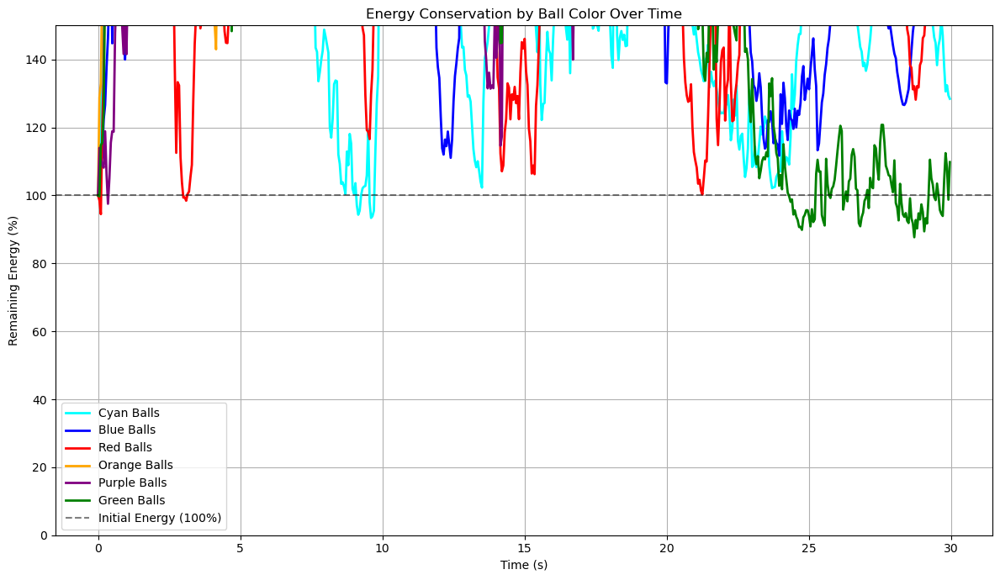


Energy conservation statistics:
------------------------------------------------------------
Color          Initial (J)       Final (J)   Loss (%)
------------------------------------------------------------
cyan               20.6088         26.4694     -28.44
blue               15.4129         26.9639     -74.94
red                 5.8593          9.5470     -62.94
orange             12.5876         32.2143    -155.92
purple              8.5949         20.3853    -137.18
green               8.1671          8.9672      -9.80
------------------------------------------------------------
TOTAL              71.2306        124.5472     -74.85


In [497]:
# Function to compute energy by color
def compute_energy_by_color(balls):
    """Calculate total energy (kinetic + potential) for each ball color"""
    energy_by_color = {}
    if not balls: # Handle empty list of balls
        return energy_by_color
    for ball in balls:
        color = ball.color
        if color not in energy_by_color:
            energy_by_color[color] = 0
        
        vx, vy = ball.vx, ball.vy
        m = ball.mass
        kinetic = 0.5 * m * (vx**2 + vy**2)
        potential = m * abs(GRAVITY) * ball.y
        energy_by_color[color] += kinetic + potential
    return energy_by_color

# --- Setup and Simulation ---
# Initialize matplotlib with proper backend handling
import matplotlib
matplotlib.use('Agg')  # Set non-interactive backend temporarily
import matplotlib.pyplot as plt

if 'balls' not in locals() or not balls:
    print("ERROR: 'balls' list is not initialized or is empty before simulation setup.")
    # Initialize with dummy data for testing if needed
    class Ball: 
        def __init__(self):
            self.color = 'red'
            self.vx = 0
            self.vy = 0
            self.mass = 1
            self.y = 10
    balls = [Ball()]
    DT = 0.01
    GRAVITY = -9.8
    width = 100
    height = 100
else:
    print(f"Number of balls at start of energy tracking: {len(balls)}")

num_steps = 600
time_points = [i * DT for i in range(num_steps)]
unique_colors = set(ball.color for ball in balls)
energy_history = {color: [] for color in unique_colors}

print(f"Unique colors found: {unique_colors}")

if not balls:
    print("Warning: No balls found to track energy for. Skipping simulation and plotting.")
else:
    # Store initial energy
    initial_energy_by_color = compute_energy_by_color(balls)
    print(f"Initial computed energy by color: {initial_energy_by_color}")
    for color_key in unique_colors:
        energy_history[color_key].append(initial_energy_by_color.get(color_key, 0))

    # Run simulation and track energy
    print(f"Running simulation for {num_steps-1} steps...")
    for step in range(1, num_steps):
        if step == 1 or step % 100 == 0:
            print(f"Simulating step {step}")
        
        # Physics updates
        for ball in balls:
            if hasattr(ball, 'apply_repulsion'):
                ball.apply_repulsion(balls)
            if hasattr(ball, 'update_position'):
                ball.update_position()
            if hasattr(ball, 'check_wall_collision'):
                ball.check_wall_collision(width, height)
        
        # Collision detection
        for i in range(len(balls)):
            for j in range(i + 1, len(balls)):
                if hasattr(balls[i], 'check_collision') and balls[i].check_collision(balls[j]):
                    if hasattr(balls[i], 'resolve_collision'):
                        balls[i].resolve_collision(balls[j])
        
        # Energy tracking
        current_energy_by_color = compute_energy_by_color(balls)
        for color_key in unique_colors:
            energy_history[color_key].append(current_energy_by_color.get(color_key, 0))

# --- Plotting Section ---
# Switch back to inline backend for display
%matplotlib inline
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 7))
plot_success = False

for color, energies in energy_history.items():
    if energies and len(energies) > 0 and energies[0] > 0:
        try:
            normalized = [e / energies[0] * 100 for e in energies]
            plt.plot(time_points[:len(normalized)], normalized, 
                    label=f"{str(color).capitalize()} Balls", 
                    color=color, linewidth=2)
            plot_success = True
        except Exception as e:
            print(f"Error plotting {color}: {str(e)}")

if plot_success:
    plt.axhline(y=100, color='black', linestyle='--', alpha=0.5, label='Initial Energy (100%)')
    plt.title('Energy Conservation by Ball Color Over Time')
    plt.xlabel('Time (s)')
    plt.ylabel('Remaining Energy (%)')
    plt.ylim(0, 150)
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    
    # Save and show plot
    plt.savefig('energy_plot.png', bbox_inches='tight')
    plt.show()
else:
    print("No valid data was plotted.")

# --- Table Printing Section ---
print("\nEnergy conservation statistics:")
if balls and any(energy_history.values()):
    print("-" * 60)
    print(f"{'Color':<10} {'Initial (J)':>15} {'Final (J)':>15} {'Loss (%)':>10}")
    print("-" * 60)
    for color, energies in energy_history.items():
        if energies and len(energies) > 0:
            initial = energies[0]
            final = energies[-1]
            if initial > 0:
                loss_percent = (1 - final/initial) * 100
                print(f"{str(color):<10} {initial:>15.4f} {final:>15.4f} {loss_percent:>10.2f}")
            else:
                print(f"{str(color):<10} {initial:>15.4f} {final:>15.4f} {'N/A':>10}")
    
    valid_colors_for_total = [c for c in energy_history if energy_history[c]]
    if valid_colors_for_total:
        total_initial = sum(energy_history[color][0] for color in valid_colors_for_total)
        total_final = sum(energy_history[color][-1] for color in valid_colors_for_total)
        total_loss_percent = (1 - total_final/total_initial) * 100 if total_initial > 0 else 0
        print("-" * 60)
        print(f"{'TOTAL':<10} {total_initial:>15.4f} {total_final:>15.4f} {total_loss_percent:>10.2f}")
else:
    print("Skipping table statistics as there are no balls or no energy history.")

# Conclusion

## Summary
This 2D physics engine successfully simulates the motion and collisions of multiple balls under the influence of gravity and friction. The use of OOP through the `Ball` class organizes the code and makes it extensible. Mathematical equations for motion and collision resolution ensure physical accuracy, while Matplotlib animations provide an intuitive visualization of the system's dynamics.

## Key Features
- **Inelastic Collisions**: The coefficient of restitution is set to 0, causing balls to lose relative velocity upon collision.
- **Realistic Physics**: Gravity and friction create a natural settling behavior, with balls eventually coming to rest.
- **Dynamic Visualization**: The animation updates in real-time, showing collisions and motion clearly.
- **Energy Analysis and Visualization**: Show the loss of energy of balls in graph and table.

This project demonstrates the power of combining OOP, physics, and visualization to create an engaging and educational simulation.